In [ ]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


### Intro yolo

In [ ]:
%cd drive/MyDrive/AdvDL_2022_3/YOLO/

/content/drive/MyDrive/AdvDL_2022_3/YOLO


In [ ]:
!git clone https://github.com/ultralytics/yolov5

fatal: destination path 'yolov5' already exists and is not an empty directory.


In [ ]:
!pwd

/content/drive/MyDrive/AdvDL_2022_3/YOLO


In [ ]:
%cd yolov5/ 

/content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5


In [ ]:
%pip install -qr requirements.txt

     |████████████████████████████████| 1.6 MB 33.3 MB/s 


In [ ]:
import torch
import utils
display = utils.notebook_init()

YOLOv5 🚀 v6.2-239-gf33718f Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)


Setup complete ✅ (4 CPUs, 25.5 GB RAM, 22.6/166.8 GB disk)


In [ ]:
# vamos a probar nuestro yolov5 predictor
!python detect.py --weights yolov5s.pt --img 640 --conf 0.25 --source data/images/

detect: weights=['yolov5s.pt'], source=data/images/, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=exp, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v6.2-239-gf33718f Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
YOLOv5s summary: 213 layers, 7225885 parameters, 0 gradients
image 1/2 /content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5/data/images/bus.jpg: 640x480 4 persons, 1 bus, 18.0ms
image 2/2 /content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5/data/images/zidane.jpg: 384x640 2 persons, 2 ties, 13.1ms
Speed: 0.6ms pre-process, 15.5ms inference, 20.6ms NMS per image at shape (1, 3, 640, 640)
Results saved to runs/detect/exp3


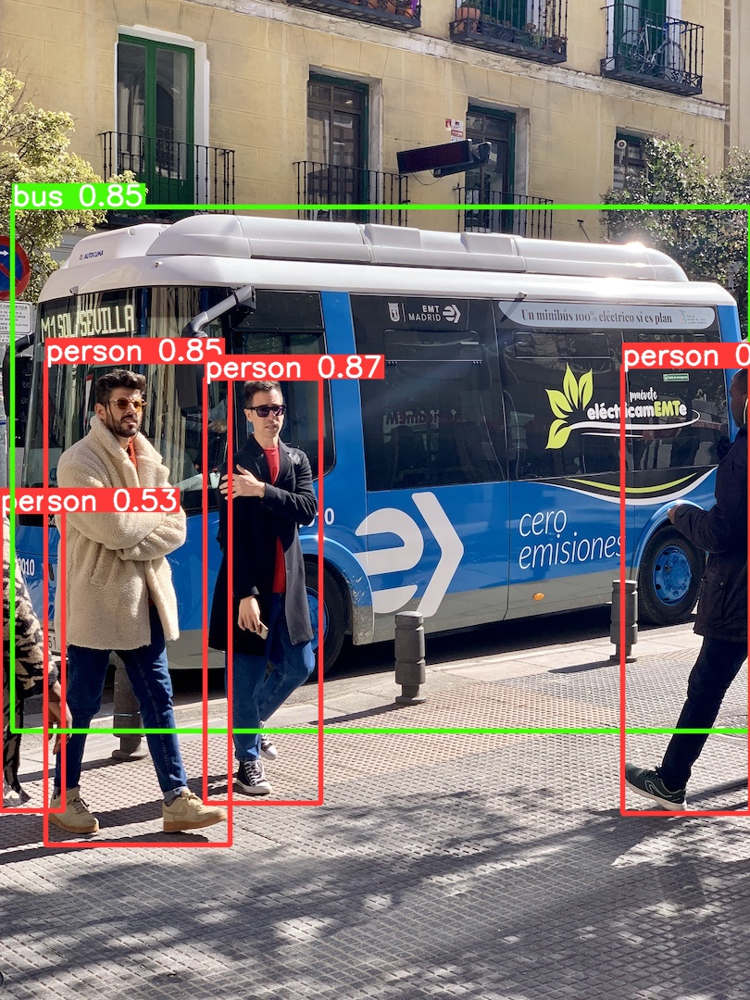

In [ ]:
display.Image(filename='runs/detect/exp2/bus.jpg')

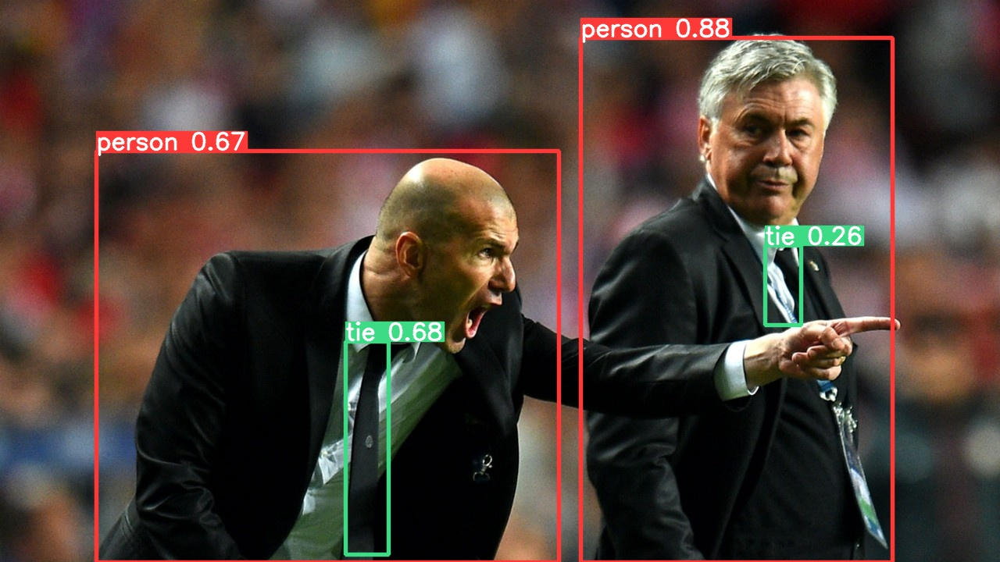

In [ ]:
display.Image(filename='runs/detect/exp2/zidane.jpg')

In [ ]:
%ls

benchmarks.py    export.py   models/           runs/      tutorial.ipynb
classify/        gun.zip     outputs/          segment/   utils/
CONTRIBUTING.md  hubconf.py  __pycache__/      setup.cfg  valid.txt
data/            LICENSE     README.md         train.py   val.py
detect.py        main.py     requirements.txt  train.txt  yolov5s.pt


In [ ]:
!unzip gun.zip

In [ ]:
%cd /content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5/data/mixed-classes-entrega
!curl -L "https://app.roboflow.com/ds/fGCdxPsNLP?key=6heGP08XiD" > roboflow.zip; unzip roboflow.zip; rm roboflow.zip


Se han truncado las últimas 5000 líneas del flujo de salida.
 extracting: train/labels/97278954e4d84cff_jpg.rf.e0a3c4432c7e645e41759f31aef6fc47.txt  
 extracting: train/labels/97280f271330cf2d_jpg.rf.b34a09865e0fbc4a36e31269b8784b09.txt  
 extracting: train/labels/9738d560f015e64c_jpg.rf.0b4a9c6452dfc869fad55abf0bd0b8d9.txt  
 extracting: train/labels/973d2e997087dff9_jpg.rf.d1a075021fde2158599b5f241bdeac43.txt  
 extracting: train/labels/973f66cc4443931c_jpg.rf.a7a554fea4c06e21105669c96f687fff.txt  
 extracting: train/labels/973fe894a0f3dd77_jpg.rf.3910f664e6b17298bee016350605f36a.txt  
 extracting: train/labels/97468322a83a5b27_jpg.rf.3a18533cb9572d85313e2152016626d4.txt  
 extracting: train/labels/974f65742edb1857_jpg.rf.3ecd44ad78632c9a1d4942f225b64166.txt  
 extracting: train/labels/9752226135fb16b4_jpg.rf.9b77a6b073e9a71497dff388926692e9.txt  
 extracting: train/labels/9752dc70250494f6_jpg.rf.0ce957d3abfe6d4db8a7fadd3d5d18a0.txt  
 extracting: train/labels/976e4078436c32f3_jpg.rf

In [ ]:
%ls

benchmarks.py    export.py   models/           runs/      tutorial.ipynb
classify/        gun.zip     outputs/          segment/   utils/
CONTRIBUTING.md  hubconf.py  __pycache__/      setup.cfg  valid.txt
data/            LICENSE     README.md         train.py   val.py
detect.py        main.py     requirements.txt  train.txt  yolov5s.pt


In [ ]:
from PIL import Image, ImageDraw
import os
import random
import numpy as np
import matplotlib.pyplot as plt
from sklearn.model_selection import train_test_split
import shutil

In [ ]:
# Corroborar la relacion entre los labels y las imagenes

def plot_bounding_box(image, annotation_list):
    annotations = np.array(annotation_list)
    w, h = image.size
    
    plotted_image = ImageDraw.Draw(image)

    transformed_annotations = np.copy(annotations)
    transformed_annotations[:,[1,3]] = annotations[:,[1,3]] * w
    transformed_annotations[:,[2,4]] = annotations[:,[2,4]] * h 
    
    transformed_annotations[:,1] = transformed_annotations[:,1] - (transformed_annotations[:,3] / 2)

    transformed_annotations[:,2] = transformed_annotations[:,2] - (transformed_annotations[:,4] / 2)
    transformed_annotations[:,3] = transformed_annotations[:,1] + transformed_annotations[:,3]
    transformed_annotations[:,4] = transformed_annotations[:,2] + transformed_annotations[:,4]
    
    for ann in transformed_annotations:
        obj_cls, x0, y0, x1, y1 = ann
        plotted_image.rectangle(((x0,y0), (x1,y1)),width=5, outline='red')
        
        #plotted_image.text((x0, y0 - 10), cla

    plt.imshow(np.array(image))
    plt.show()

# Get any random annotation file 
annotations = [os.path.join('labels', x) for x in os.listdir('labels') if x[-3:] == "txt"]
annotation_file = random.choice(annotations)
with open(annotation_file, "r") as file:
    annotation_list = file.read().split("\n")[:-1]
    annotation_list = [x.split(" ") for x in annotation_list]
    annotation_list = [[float(y) for y in x ] for x in annotation_list]
#print(annotation_list)

image_file = annotation_file.replace("labels", "images").replace("txt", "jpg")
assert os.path.exists(image_file)
#plt.imshow(np.array(image))
#plt.show()

#Load the image
image = Image.open(image_file)

#Plot the Bounding Box
plot_bounding_box(image, annotation_list)

In [ ]:
#vamos a particionar los datos en conjuntos de train, validation y test
images = [os.path.join('data/guns/images',x) for x in os.listdir('data/guns/images') if x[-3:]=='jpg']
labels = [os.path.join('data/guns/labels',x) for x in os.listdir('data/guns/labels') if x[-3:]=='txt']

images.sort()
labels.sort()

#Hacer nuestras particiones 80% train, 10% validation , 10% test
train_images, val_images, train_annotations, val_annotations = train_test_split(images, labels, test_size=0.2, random_state=1)
val_images, test_images, val_annotations, test_annotations = train_test_split(val_images, val_annotations, test_size=0.5, random_state=1)

In [ ]:
!mkdir data/guns/images/train data/guns/images/val data/guns/images/test 
!mkdir data/guns/labels/train data/guns/labels/val data/guns/labels/test
#!mkdir data/guns/labels/val data/guns/labels/test

In [ ]:
#crear una funcion que me permita mover archivos
def move_files_to_folder(list_of_files, destination_folder):
  for f in list_of_files:
    try:
      shutil.move(f, destination_folder)
    except:
      print(f)
      assert False

In [ ]:
move_files_to_folder(train_images, 'data/guns/images/train')
move_files_to_folder(val_images, 'data/guns/images/val')
move_files_to_folder(test_images, 'data/guns/images/test')
move_files_to_folder(train_annotations, 'data/guns/labels/train')
move_files_to_folder(val_annotations, 'data/guns/labels/val')
move_files_to_folder(test_annotations, 'data/guns/labels/test')

### Yolo standar

In [ ]:
!python train.py --img 416 --cfg yolov5s_mixedfinal_base.yaml --hyp hyp.scratch-low.yaml --batch 16 --epochs 100 --data mixedfinal.yaml --weights yolov5s.pt --workers 24 --name yolo_mixedfinal_base_det

train: weights=yolov5s.pt, cfg=yolov5s_mixedfinal_base.yaml, data=mixedfinal.yaml, hyp=hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=24, project=runs/train, name=yolo_mixedfinal_base_det, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: ⚠️ YOLOv5 is out of date by 37 commits. Use `git pull` or `git clone https://github.com/ultralytics/yolov5` to update.
YOLOv5 🚀 v6.2-239-gf33718f Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5,

In [ ]:
#vamos a usaar el detector
!python detect.py --source data/mixed-classes-entrega/test/images/ --weights runs/train/yolo_mixedfinal_base_det2/weights/best.pt --conf 0.25 --name yolo_mixedfinal_base_det #se adiciona un numero una vez termine el entrenamiento


detect: weights=['runs/train/yolo_mixedfinal_base_det2/weights/best.pt'], source=data/mixed-classes-entrega/test/images/, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=yolo_mixedfinal_base_det, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v6.2-239-gf33718f Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
YOLOv5s_mixedfinal_base summary: 157 layers, 7023610 parameters, 0 gradients, 15.8 GFLOPs
image 1/747 /content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5/data/mixed-classes-entrega/test/images/0002cebd6f0cd7e1_jpg.rf.44393bfbc757961a0952a14a56f3b7c1.jpg: 640x640 (no detections), 12.7ms
image 2/747 /content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5/data/mixed-c

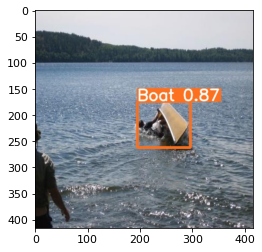

In [ ]:
#Resultados aeleatorios sobre el conjunto de test
detections_dir = 'runs/detect/yolo_mixedfinal_base_det4'
detection_images = [os.path.join(detections_dir, x) for x in os.listdir(detections_dir)]
random_image = Image.open(random.choice(detection_images))
plt.imshow(np.array(random_image))


In [ ]:
#Para mostrar los resultado graficos
from utils.plots import plot_results
plot_results('runs/train/yolo_mixedfinal_base_det2/results.csv') #poner el ultimo 


<function matplotlib.pyplot.show(*args, **kw)>

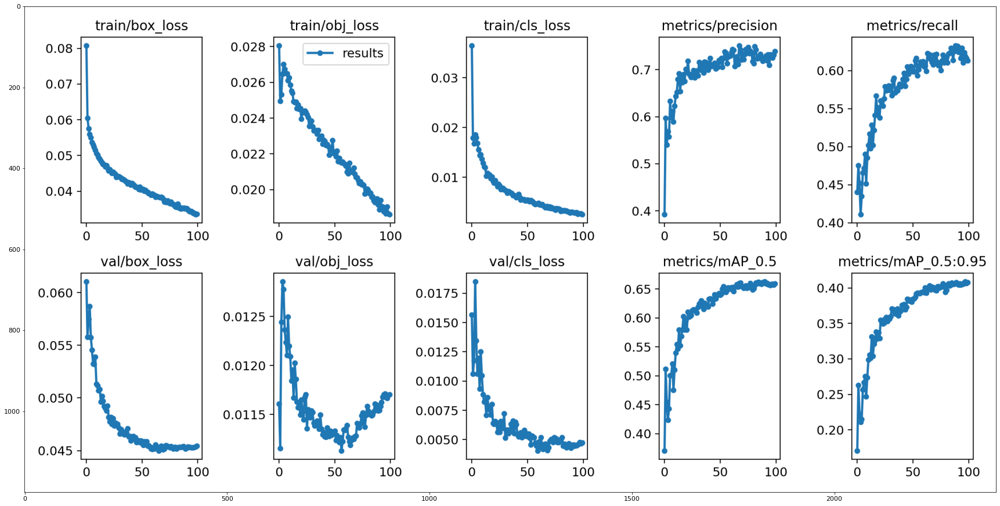

In [ ]:
images = Image.open('runs/train/yolo_mixedfinal_base_det2/results.png')
plt.figure(figsize=(30,30))
plt.imshow(np.array(images))
plt.show

### YOLO SE

In [ ]:
!python train.py --img 416 --cfg yolov5s_mixedfinal_SE.yaml --hyp hyp.scratch-low.yaml --batch 16 --epochs 100 --data mixedfinal.yaml --weights yolov5s.pt --workers 24 --name yolo_mixedfinal_se_det

train: weights=yolov5s.pt, cfg=yolov5s_mixedfinal_SE.yaml, data=mixedfinal.yaml, hyp=hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=24, project=runs/train, name=yolo_mixedfinal_se_det, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
remote: Enumerating objects: 3, done.
remote: Counting objects: 100% (3/3), done.
remote: Compressing objects: 100% (3/3), done.
remote: Total 3 (delta 0), reused 0 (delta 0), pack-reused 0
Unpacking objects: 100% (3/3), done.
From https://github.com/ultralytics/yolov5
   85f8379..350e8eb  master     -> origin/master
github: ⚠️ YOLOv5 is out of date by 37 commits. Use `

In [ ]:
#Para mostrar los resultado graficos
from utils.plots import plot_results
plot_results('runs/train/yolo_mixedfinal_se_det/results.csv') #poner el ultimo 

<function matplotlib.pyplot.show(*args, **kw)>

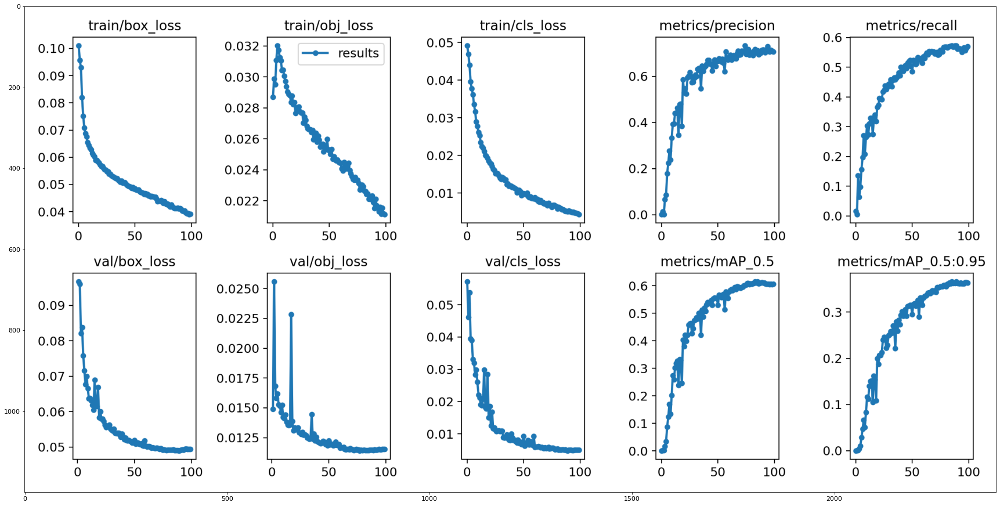

In [ ]:
images = Image.open('runs/train/yolo_mixedfinal_se_det/results.png')
plt.figure(figsize=(30,30))
plt.imshow(np.array(images))
plt.show

In [ ]:
!pwd

/content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5


In [ ]:
# vamos a probar nuestro yolov5 predictor
#!python detect.py --weights runs/train/yolo_mixedfinal_se_det/weights/best.pt --img 416 --conf 0.25 --source data/mixed-classes-entrega/test/images --name yolo_mixedfinal_base_det
!python detect.py --source data/mixed-classes-entrega/test/images/ --weights runs/train/yolo_mixedfinal_se_det/weights/best.pt --conf 0.25 --name yolo_mixedfinal_se_det

detect: weights=['runs/train/yolo_mixedfinal_se_det/weights/best.pt'], source=data/mixed-classes-entrega/test/images/, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, save_crop=False, nosave=False, classes=None, agnostic_nms=False, augment=False, visualize=False, update=False, project=runs/detect, name=yolo_mixedfinal_se_det, exist_ok=False, line_thickness=3, hide_labels=False, hide_conf=False, half=False, dnn=False, vid_stride=1
YOLOv5 🚀 v6.2-239-gf33718f Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
YOLOv5s_mixedfinal_SE summary: 273 layers, 46946970 parameters, 0 gradients, 108.8 GFLOPs
image 1/747 /content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5/data/mixed-classes-entrega/test/images/0002cebd6f0cd7e1_jpg.rf.44393bfbc757961a0952a14a56f3b7c1.jpg: 640x640 (no detections), 53.5ms
image 2/747 /content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5/data/mixed-classe

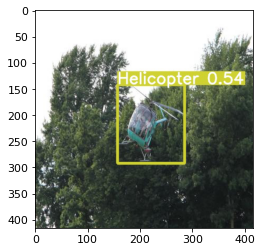

In [ ]:
#Resultados aeleatorios sobre el conjunto de test
detections_dir = 'runs/detect/yolo_mixedfinal_se_det'
detection_images = [os.path.join(detections_dir, x) for x in os.listdir(detections_dir)]
random_image = Image.open(random.choice(detection_images))
plt.imshow(np.array(random_image))

<function matplotlib.pyplot.show(*args, **kw)>

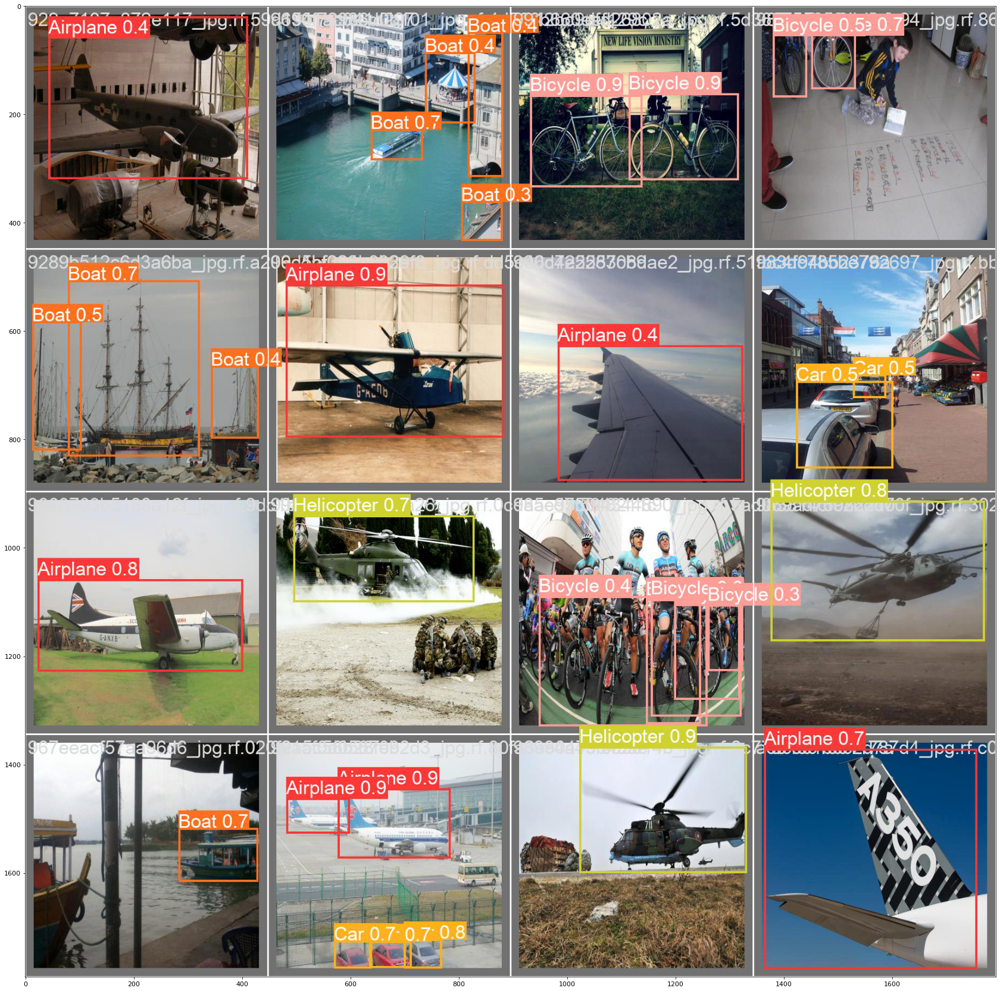

In [ ]:
images = Image.open('runs/train/yolo_mixedfinal_se_det/val_batch2_pred.jpg')
plt.figure(figsize=(30,30))
plt.imshow(np.array(images))
plt.show

### YOLO CBAM

In [ ]:
!python train.py --img 416 --cfg yolov5s_mixedfinal.yaml --hyp hyp.scratch-low.yaml --batch 16 --epochs 100 --data mixedfinal.yaml --weights yolov5s.pt --workers 24 --name yolo_mixedfinal_cbam_det

train: weights=yolov5s.pt, cfg=yolov5s_mixedfinal.yaml, data=mixedfinal.yaml, hyp=hyp.scratch-low.yaml, epochs=100, batch_size=16, imgsz=416, rect=False, resume=False, nosave=False, noval=False, noautoanchor=False, noplots=False, evolve=None, bucket=, cache=None, image_weights=False, device=, multi_scale=False, single_cls=False, optimizer=SGD, sync_bn=False, workers=24, project=runs/train, name=yolo_mixedfinal_cbam_det, exist_ok=False, quad=False, cos_lr=False, label_smoothing=0.0, patience=100, freeze=[0], save_period=-1, seed=0, local_rank=-1, entity=None, upload_dataset=False, bbox_interval=-1, artifact_alias=latest
github: ⚠️ YOLOv5 is out of date by 37 commits. Use `git pull` or `git clone https://github.com/ultralytics/yolov5` to update.
YOLOv5 🚀 v6.2-239-gf33718f Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

hyperparameters: lr0=0.01, lrf=0.01, momentum=0.937, weight_decay=0.0005, warmup_epochs=3.0, warmup_momentum=0.8, warmup_bias_lr=0.1, box=0.05, cls=0.5, cls_

In [ ]:
#Para mostrar los resultado graficos
from utils.plots import plot_results
plot_results('runs/train/yolo_mixedfinal_cbam_det/results.csv') #poner el ultimo 

<function matplotlib.pyplot.show(*args, **kw)>

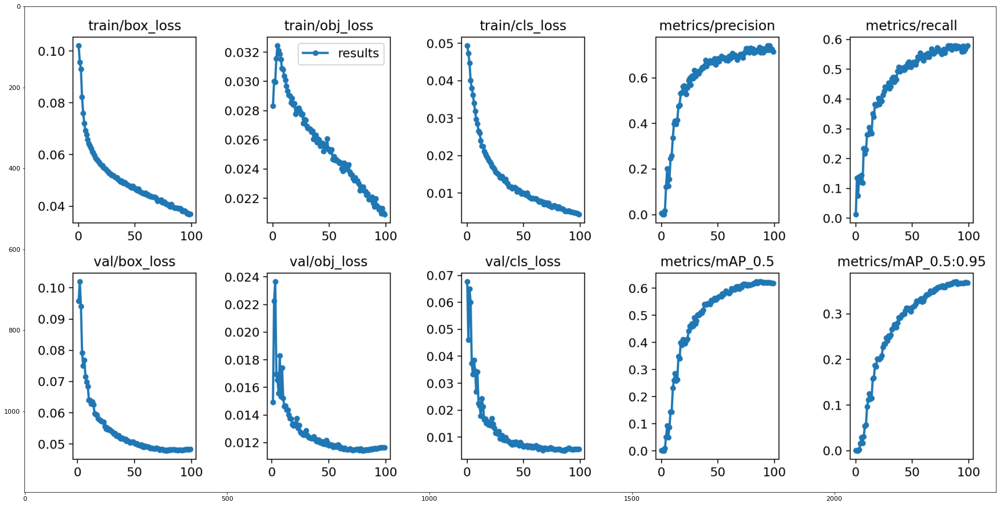

In [ ]:
images = Image.open('runs/train/yolo_mixedfinal_cbam_det/results.png')
plt.figure(figsize=(30,30))
plt.imshow(np.array(images))
plt.show

In [ ]:
# vamos a probar nuestro yolov5 predictor
#!python detect.py --weights runs/train/yolo_mixedfinal_se_det/weights/best.pt --img 416 --conf 0.25 --source data/mixed-classes-entrega/test/images --name yolo_mixedfinal_base_det
!python detect.py --source data/mixed-classes-entrega/test/images/ --weights # vamos a probar nuestro yolov5 predictor
#!python detect.py --weights runs/train/yolo_mixedfinal_se_det/weights/best.pt --img 416 --conf 0.25 --source data/mixed-classes-entrega/test/images --name yolo_mixedfinal_base_det
!python detect.py --source data/mixed-classes-entrega/test/images/ --weights runs/train/yolo_mixedfinal_se_det/weights/best.pt --conf 0.25 --name yolo_mixedfinal_se_det/weights/best.pt --conf 0.25 --name yolo_mixedfinal_cbam_det

usage: detect.py [-h] [--weights WEIGHTS [WEIGHTS ...]] [--source SOURCE]
                 [--data DATA] [--imgsz IMGSZ [IMGSZ ...]]
                 [--conf-thres CONF_THRES] [--iou-thres IOU_THRES]
                 [--max-det MAX_DET] [--device DEVICE] [--view-img]
                 [--save-txt] [--save-conf] [--save-crop] [--nosave]
                 [--classes CLASSES [CLASSES ...]] [--agnostic-nms]
                 [--augment] [--visualize] [--update] [--project PROJECT]
                 [--name NAME] [--exist-ok] [--line-thickness LINE_THICKNESS]
                 [--hide-labels] [--hide-conf] [--half] [--dnn]
                 [--vid-stride VID_STRIDE]
detect.py: error: argument --weights: expected at least one argument
detect: weights=['runs/train/yolo_mixedfinal_se_det/weights/best.pt'], source=data/mixed-classes-entrega/test/images/, data=data/coco128.yaml, imgsz=[640, 640], conf_thres=0.25, iou_thres=0.45, max_det=1000, device=, view_img=False, save_txt=False, save_conf=False, s

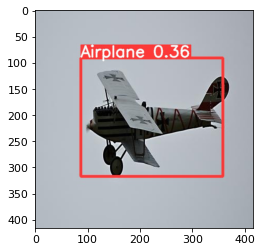

In [ ]:
#Resultados aeleatorios sobre el conjunto de test
detections_dir = 'runs/detect/yolo_mixedfinal_cbam_det'
detection_images = [os.path.join(detections_dir, x) for x in os.listdir(detections_dir)]
random_image = Image.open(random.choice(detection_images))
plt.imshow(np.array(random_image))

<function matplotlib.pyplot.show(*args, **kw)>

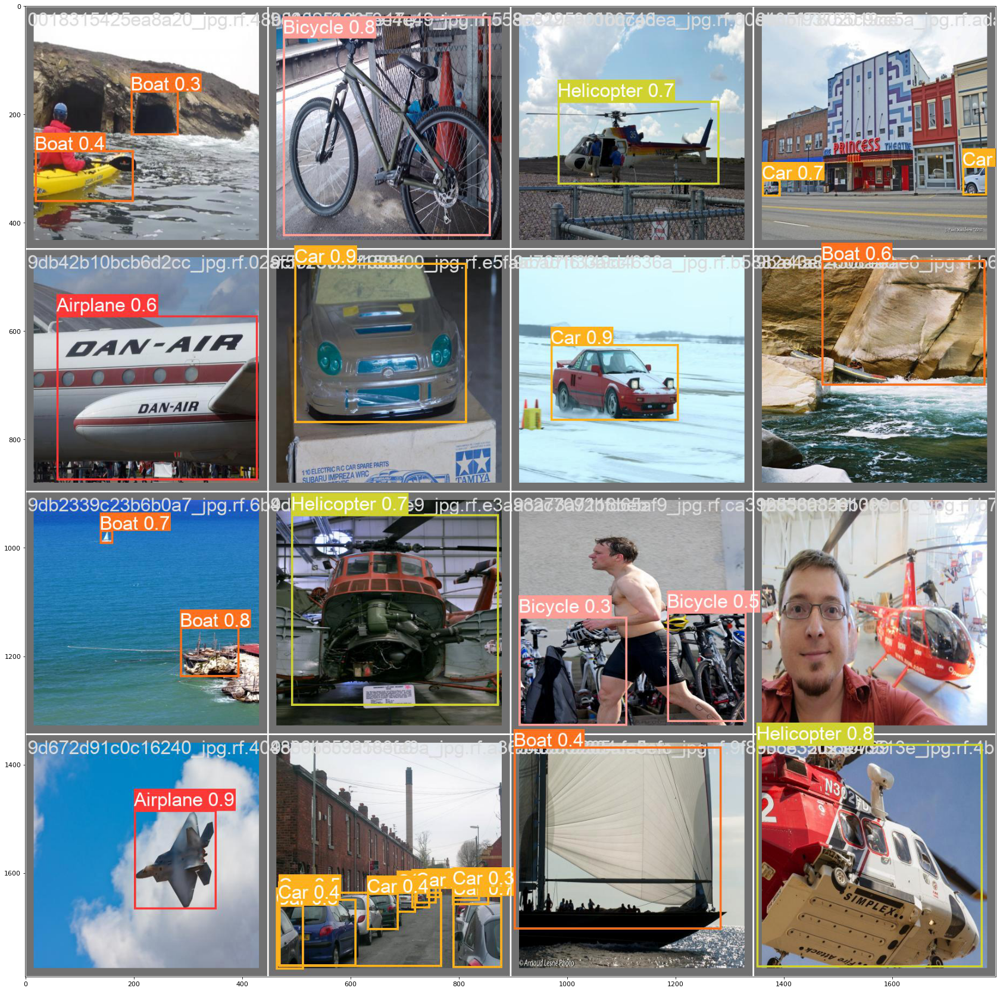

In [ ]:
# first, display our ground truth data
#print("GROUND TRUTH TRAINING DATA:")
#plot_results('runs/train/yolo_mixedfinal_cbam_det/val_batch0_pred.jpg')

images = Image.open('runs/train/yolo_mixedfinal_cbam_det/val_batch0_pred.jpg')
plt.figure(figsize=(30,30))
plt.imshow(np.array(images))
plt.show

### EIGENCAM_Yolo-standar

In [ ]:
!pip install grad-cam

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 7.8 MB 18.6 MB/s 
  Installing build dependencies ... done
  Getting requirements to build wheel ... done
    Preparing wheel metadata ... done
  Created wheel for grad-cam: filename=grad_cam-1.4.6-py3-none-any.whl size=38261 sha256=aebedd94eb7e7cad9223debadd648ac6cdc68924aa3d747734ce9b8259a55316
  Stored in directory: /root/.cache/pip/wheels/a4/6a/11/fa213a7aaae1a99a800b86bdd1cc95bc9c7d7914b0859663b8
Successfully built grad-cam


In [ ]:
import warnings
warnings.filterwarnings('ignore')
warnings.simplefilter('ignore')
##import torch    
import cv2
##import numpy as np
import requests
import torchvision.transforms as transforms
from pytorch_grad_cam import EigenCAM
from pytorch_grad_cam.utils.image import show_cam_on_image, scale_cam_image
#from PIL import Image

COLORS = np.random.uniform(0, 255, size=(80, 3))

def parse_detections(results):
    detections = results.pandas().xyxy[0]
    detections = detections.to_dict()
    boxes, colors, names = [], [], []

    for i in range(len(detections["xmin"])):
        confidence = detections["confidence"][i]
        if confidence < 0.2:
            continue
        xmin = int(detections["xmin"][i])
        ymin = int(detections["ymin"][i])
        xmax = int(detections["xmax"][i])
        ymax = int(detections["ymax"][i])
        name = detections["name"][i]
        category = int(detections["class"][i])
        color = COLORS[category]

        boxes.append((xmin, ymin, xmax, ymax))
        colors.append(color)
        names.append(name)
    return boxes, colors, names


def draw_detections(boxes, colors, names, img):
    for box, color, name in zip(boxes, colors, names):
        xmin, ymin, xmax, ymax = box
        cv2.rectangle(
            img,
            (xmin, ymin),
            (xmax, ymax),
            color, 
            2)

        cv2.putText(img, name, (xmin, ymin - 5),
                    cv2.FONT_HERSHEY_SIMPLEX, 0.8, color, 2,
                    lineType=cv2.LINE_AA)
    return img

YOLOv5 🚀 v6.2-239-gf33718f Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
YOLOv5s_mixedfinal_base summary: 157 layers, 7023610 parameters, 0 gradients, 15.8 GFLOPs
Adding AutoShape... 


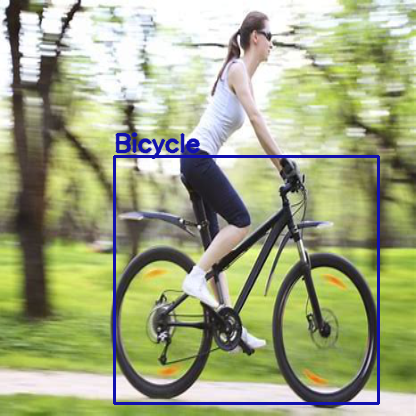

In [ ]:
img=np.array(Image.open('data/mixed-classes-entrega/valid/images/bicycle.jpg'))
img=cv2.resize(img,(416,416))
rgb_img=img.copy()
img=np.float32(img)/255
transform=transforms.ToTensor()
tensor=transform(img).unsqueeze(0)

path_yolo='/content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5'
#path_own_model='yolo5s_gun'
best_weights='/content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5/runs/train/yolo_mixedfinal_base_det2/weights/best.pt'
model=torch.hub.load(path_yolo,'custom', best_weights,source='local')
#
model.eval()
model.cpu()
target_layers=[model.model.model.model[-2]]

results=model([rgb_img])
boxes, colors, names = parse_detections(results)
detections=draw_detections(boxes, colors,names,rgb_img.copy())
Image.fromarray(detections)


YOLOv5 🚀 v6.2-239-gf33718f Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
YOLOv5s_mixedfinal_base summary: 157 layers, 7023610 parameters, 0 gradients, 15.8 GFLOPs
Adding AutoShape... 


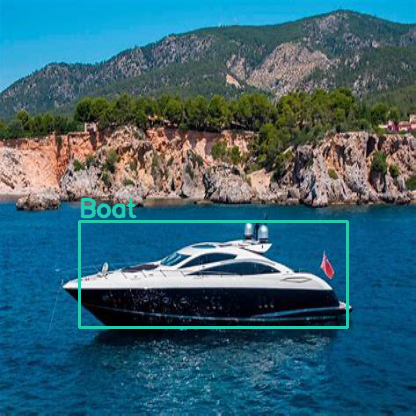

In [ ]:
img=np.array(Image.open('data/mixed-classes-entrega/valid/images/boat.jpg'))
img=cv2.resize(img,(416,416))
rgb_img=img.copy()
img=np.float32(img)/255
transform=transforms.ToTensor()
tensor=transform(img).unsqueeze(0)

path_yolo='/content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5'
#path_own_model='yolo5s_gun'
best_weights='/content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5/runs/train/yolo_mixedfinal_base_det2/weights/best.pt'
model=torch.hub.load(path_yolo,'custom', best_weights,source='local')
#
model.eval()
model.cpu()
target_layers=[model.model.model.model[-2]]

results=model([rgb_img])
boxes, colors, names = parse_detections(results)
detections=draw_detections(boxes, colors,names,rgb_img.copy())
Image.fromarray(detections)

YOLOv5 🚀 v6.2-239-gf33718f Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
YOLOv5s_mixedfinal_base summary: 157 layers, 7023610 parameters, 0 gradients, 15.8 GFLOPs
Adding AutoShape... 


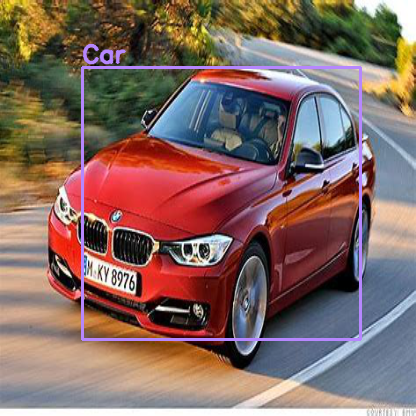

In [ ]:
img=np.array(Image.open('data/mixed-classes-entrega/valid/images/car.jpg'))
img=cv2.resize(img,(416,416))
rgb_img=img.copy()
img=np.float32(img)/255
transform=transforms.ToTensor()
tensor=transform(img).unsqueeze(0)

path_yolo='/content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5'
#path_own_model='yolo5s_gun'
best_weights='/content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5/runs/train/yolo_mixedfinal_base_det2/weights/best.pt'
model=torch.hub.load(path_yolo,'custom', best_weights,source='local')
#
model.eval()
model.cpu()
target_layers=[model.model.model.model[-2]]

results=model([rgb_img])
boxes, colors, names = parse_detections(results)
detections=draw_detections(boxes, colors,names,rgb_img.copy())
Image.fromarray(detections)

YOLOv5 🚀 v6.2-239-gf33718f Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
YOLOv5s_mixedfinal_base summary: 157 layers, 7023610 parameters, 0 gradients, 15.8 GFLOPs
Adding AutoShape... 


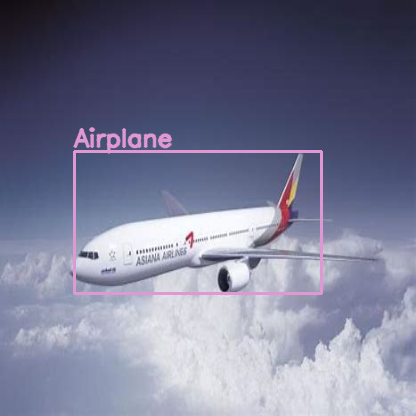

In [ ]:
img=np.array(Image.open('data/mixed-classes-entrega/valid/images/airplane.jpg'))
img=cv2.resize(img,(416,416))
rgb_img=img.copy()
img=np.float32(img)/255
transform=transforms.ToTensor()
tensor=transform(img).unsqueeze(0)

path_yolo='/content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5'
#path_own_model='yolo5s_gun'
best_weights='/content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5/runs/train/yolo_mixedfinal_base_det2/weights/best.pt'
model=torch.hub.load(path_yolo,'custom', best_weights,source='local')
#
model.eval()
model.cpu()
target_layers=[model.model.model.model[-2]]

results=model([rgb_img])
boxes, colors, names = parse_detections(results)
detections=draw_detections(boxes, colors,names,rgb_img.copy())
Image.fromarray(detections)

YOLOv5 🚀 v6.2-239-gf33718f Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
YOLOv5s_mixedfinal_base summary: 157 layers, 7023610 parameters, 0 gradients, 15.8 GFLOPs
Adding AutoShape... 


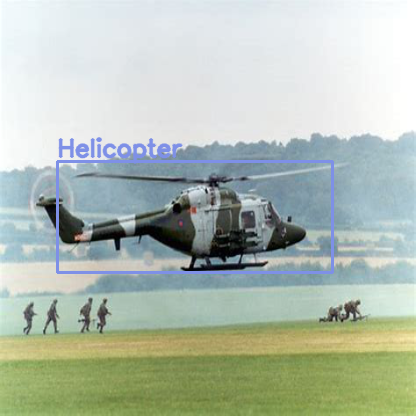

In [ ]:
img=np.array(Image.open('data/mixed-classes-entrega/valid/images/helicopter.jpg'))
img=cv2.resize(img,(416,416))
rgb_img=img.copy()
img=np.float32(img)/255
transform=transforms.ToTensor()
tensor=transform(img).unsqueeze(0)

path_yolo='/content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5'
#path_own_model='yolo5s_gun'
best_weights='/content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5/runs/train/yolo_mixedfinal_base_det2/weights/best.pt'
model=torch.hub.load(path_yolo,'custom', best_weights,source='local')
#
model.eval()
model.cpu()
target_layers=[model.model.model.model[-2]]

results=model([rgb_img])
boxes, colors, names = parse_detections(results)
detections=draw_detections(boxes, colors,names,rgb_img.copy())
Image.fromarray(detections)

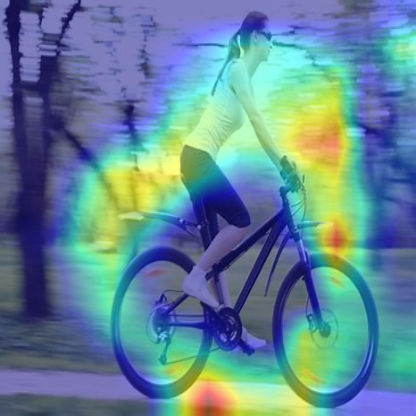

In [ ]:
cam=EigenCAM(model, target_layers, use_cuda=False)
grayscale_cam=cam(tensor)[0, :, :]
cam_image=show_cam_on_image(img, grayscale_cam,use_rgb=True)
Image.fromarray(cam_image)

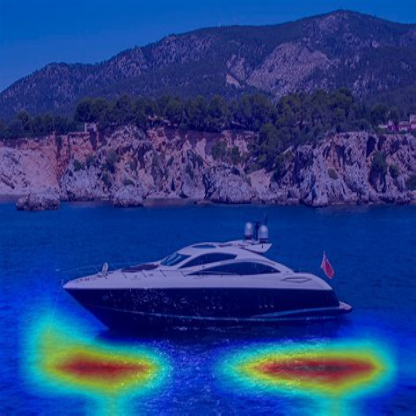

In [ ]:
cam=EigenCAM(model, target_layers, use_cuda=False)
grayscale_cam=cam(tensor)[0, :, :]
cam_image=show_cam_on_image(img, grayscale_cam,use_rgb=True)
Image.fromarray(cam_image)

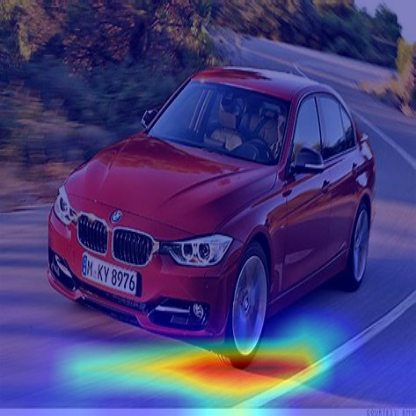

In [ ]:
cam=EigenCAM(model, target_layers, use_cuda=False)
grayscale_cam=cam(tensor)[0, :, :]
cam_image=show_cam_on_image(img, grayscale_cam,use_rgb=True)
Image.fromarray(cam_image)

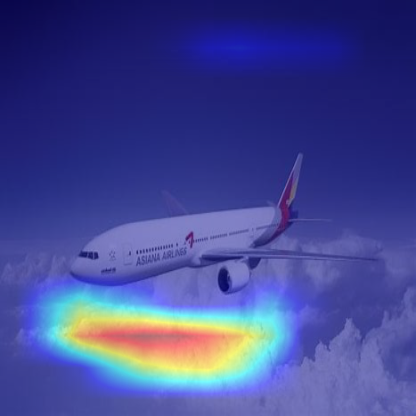

In [ ]:
cam=EigenCAM(model, target_layers, use_cuda=False)
grayscale_cam=cam(tensor)[0, :, :]
cam_image=show_cam_on_image(img, grayscale_cam,use_rgb=True)
Image.fromarray(cam_image)

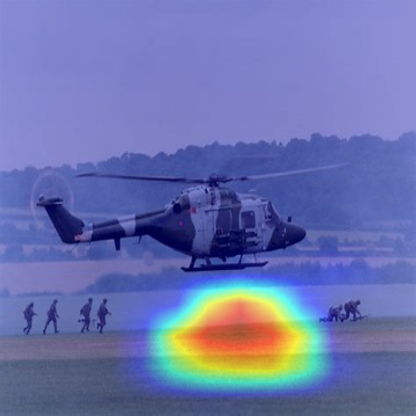

In [ ]:
cam=EigenCAM(model, target_layers, use_cuda=False)
grayscale_cam=cam(tensor)[0, :, :]
cam_image=show_cam_on_image(img, grayscale_cam,use_rgb=True)
Image.fromarray(cam_image)

In [ ]:
def renormalize_cam_in_bounding_boxes(boxes, colors, names, image_float_np, grayscale_cam):
    """Normalize the CAM to be in the range [0, 1] 
    inside every bounding boxes, and zero outside of the bounding boxes. """
    renormalized_cam = np.zeros(grayscale_cam.shape, dtype=np.float32)
    for x1, y1, x2, y2 in boxes:
        renormalized_cam[y1:y2, x1:x2] = scale_cam_image(grayscale_cam[y1:y2, x1:x2].copy())    
    renormalized_cam = scale_cam_image(renormalized_cam)
    eigencam_image_renormalized = show_cam_on_image(image_float_np, renormalized_cam, use_rgb=True)
    image_with_bounding_boxes = draw_detections(boxes, colors, names, eigencam_image_renormalized)
    return image_with_bounding_boxes

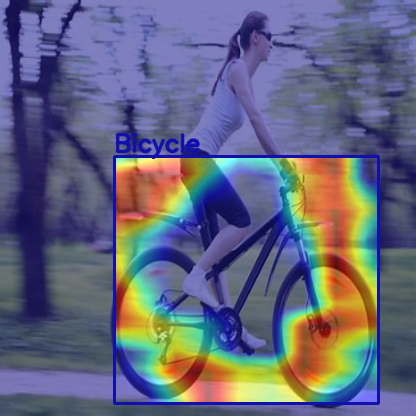

In [ ]:
renormalized_cam_image = renormalize_cam_in_bounding_boxes(boxes, colors, names, img, grayscale_cam)
Image.fromarray(renormalized_cam_image)

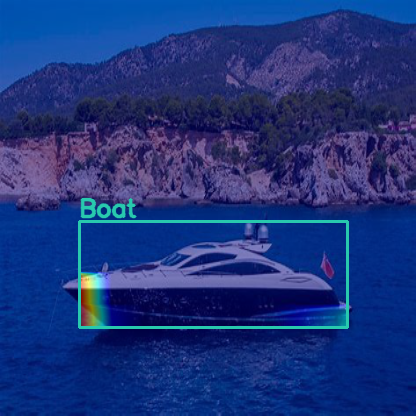

In [ ]:
renormalized_cam_image = renormalize_cam_in_bounding_boxes(boxes, colors, names, img, grayscale_cam)
Image.fromarray(renormalized_cam_image)

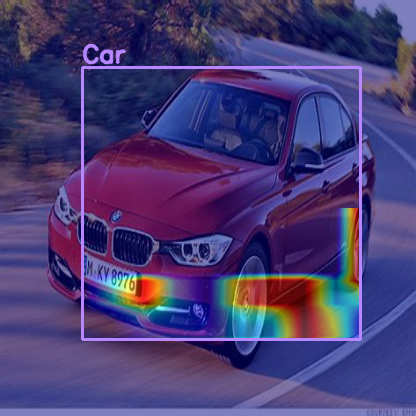

In [ ]:
renormalized_cam_image = renormalize_cam_in_bounding_boxes(boxes, colors, names, img, grayscale_cam)
Image.fromarray(renormalized_cam_image)

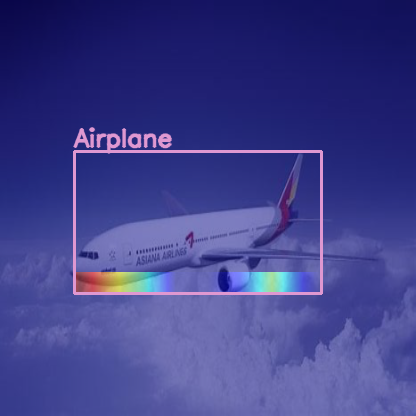

In [ ]:
renormalized_cam_image = renormalize_cam_in_bounding_boxes(boxes, colors, names, img, grayscale_cam)
Image.fromarray(renormalized_cam_image)

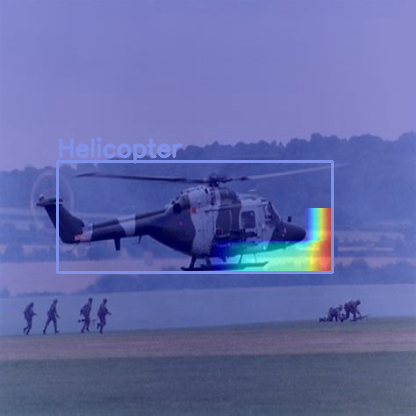

In [ ]:
renormalized_cam_image = renormalize_cam_in_bounding_boxes(boxes, colors, names, img, grayscale_cam)
Image.fromarray(renormalized_cam_image)

### EIGENCAM_ SE

YOLOv5 🚀 v6.2-239-gf33718f Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
YOLOv5s_mixedfinal_SE summary: 273 layers, 46946970 parameters, 0 gradients, 108.8 GFLOPs
Adding AutoShape... 


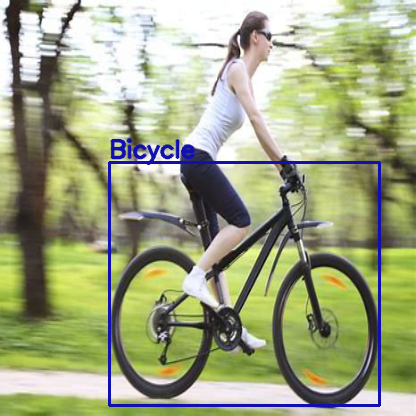

In [ ]:
img=np.array(Image.open('data/mixed-classes-entrega/valid/images/bicycle.jpg'))
img=cv2.resize(img,(416,416))
rgb_img=img.copy()
img=np.float32(img)/255
transform=transforms.ToTensor()
tensor=transform(img).unsqueeze(0)

path_yolo='/content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5'
#path_own_model='yolo5s_gun'
best_weights='/content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5/runs/train/yolo_mixedfinal_se_det/weights/best.pt'
model=torch.hub.load(path_yolo,'custom', best_weights,source='local',force_reload=True) #,force_reload=True es parametro fuerza a que se busque en el comm.py local
#
model.eval()
model.cpu()
target_layers=[model.model.model.model[-2]]

results=model([rgb_img])
boxes, colors, names = parse_detections(results)
detections=draw_detections(boxes, colors,names,rgb_img.copy())
Image.fromarray(detections)

YOLOv5 🚀 v6.2-239-gf33718f Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
YOLOv5s_mixedfinal_SE summary: 273 layers, 46946970 parameters, 0 gradients, 108.8 GFLOPs
Adding AutoShape... 


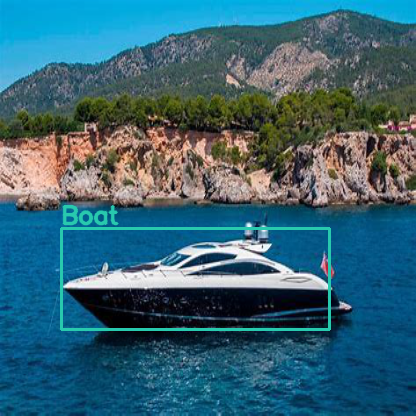

In [ ]:
img=np.array(Image.open('data/mixed-classes-entrega/valid/images/boat.jpg'))
img=cv2.resize(img,(416,416))
rgb_img=img.copy()
img=np.float32(img)/255
transform=transforms.ToTensor()
tensor=transform(img).unsqueeze(0)

path_yolo='/content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5'
#path_own_model='yolo5s_gun'
best_weights='/content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5/runs/train/yolo_mixedfinal_se_det/weights/best.pt'
model=torch.hub.load(path_yolo,'custom', best_weights,source='local',force_reload=True) #,force_reload=True es parametro fuerza a que se busque en el comm.py local
#
model.eval()
model.cpu()
target_layers=[model.model.model.model[-2]]

results=model([rgb_img])
boxes, colors, names = parse_detections(results)
detections=draw_detections(boxes, colors,names,rgb_img.copy())
Image.fromarray(detections)

YOLOv5 🚀 v6.2-239-gf33718f Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
YOLOv5s_mixedfinal_SE summary: 273 layers, 46946970 parameters, 0 gradients, 108.8 GFLOPs
Adding AutoShape... 


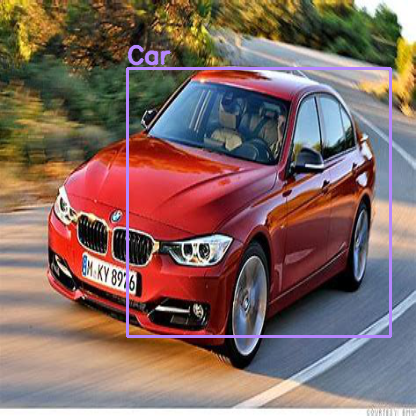

In [ ]:
img=np.array(Image.open('data/mixed-classes-entrega/valid/images/car.jpg'))
img=cv2.resize(img,(416,416))
rgb_img=img.copy()
img=np.float32(img)/255
transform=transforms.ToTensor()
tensor=transform(img).unsqueeze(0)

path_yolo='/content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5'
#path_own_model='yolo5s_gun'
best_weights='/content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5/runs/train/yolo_mixedfinal_se_det/weights/best.pt'
model=torch.hub.load(path_yolo,'custom', best_weights,source='local',force_reload=True) #,force_reload=True es parametro fuerza a que se busque en el comm.py local
#
model.eval()
model.cpu()
target_layers=[model.model.model.model[-2]]

results=model([rgb_img])
boxes, colors, names = parse_detections(results)
detections=draw_detections(boxes, colors,names,rgb_img.copy())
Image.fromarray(detections)

YOLOv5 🚀 v6.2-239-gf33718f Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
YOLOv5s_mixedfinal_SE summary: 273 layers, 46946970 parameters, 0 gradients, 108.8 GFLOPs
Adding AutoShape... 


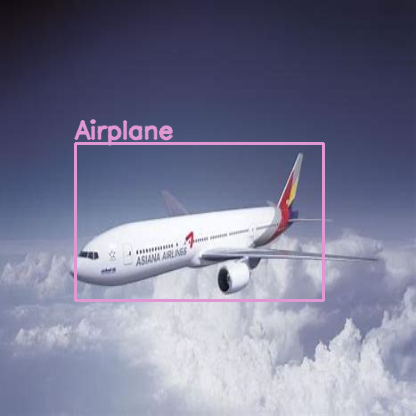

In [ ]:
img=np.array(Image.open('data/mixed-classes-entrega/valid/images/airplane.jpg'))
img=cv2.resize(img,(416,416))
rgb_img=img.copy()
img=np.float32(img)/255
transform=transforms.ToTensor()
tensor=transform(img).unsqueeze(0)

path_yolo='/content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5'
#path_own_model='yolo5s_gun'
best_weights='/content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5/runs/train/yolo_mixedfinal_se_det/weights/best.pt'
model=torch.hub.load(path_yolo,'custom', best_weights,source='local',force_reload=True) #,force_reload=True es parametro fuerza a que se busque en el comm.py local
#
model.eval()
model.cpu()
target_layers=[model.model.model.model[-2]]

results=model([rgb_img])
boxes, colors, names = parse_detections(results)
detections=draw_detections(boxes, colors,names,rgb_img.copy())
Image.fromarray(detections)

YOLOv5 🚀 v6.2-239-gf33718f Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
YOLOv5s_mixedfinal_SE summary: 273 layers, 46946970 parameters, 0 gradients, 108.8 GFLOPs
Adding AutoShape... 


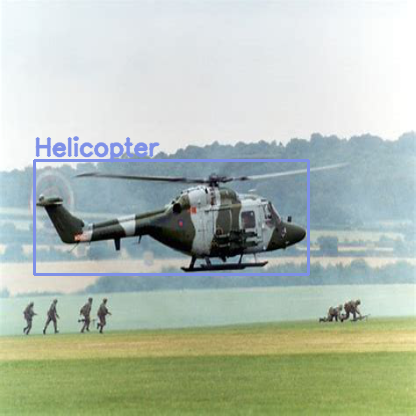

In [ ]:
img=np.array(Image.open('data/mixed-classes-entrega/valid/images/helicopter.jpg'))
img=cv2.resize(img,(416,416))
rgb_img=img.copy()
img=np.float32(img)/255
transform=transforms.ToTensor()
tensor=transform(img).unsqueeze(0)

path_yolo='/content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5'
#path_own_model='yolo5s_gun'
best_weights='/content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5/runs/train/yolo_mixedfinal_se_det/weights/best.pt'
model=torch.hub.load(path_yolo,'custom', best_weights,source='local',force_reload=True) #,force_reload=True es parametro fuerza a que se busque en el comm.py local
#
model.eval()
model.cpu()
target_layers=[model.model.model.model[-2]]

results=model([rgb_img])
boxes, colors, names = parse_detections(results)
detections=draw_detections(boxes, colors,names,rgb_img.copy())
Image.fromarray(detections)

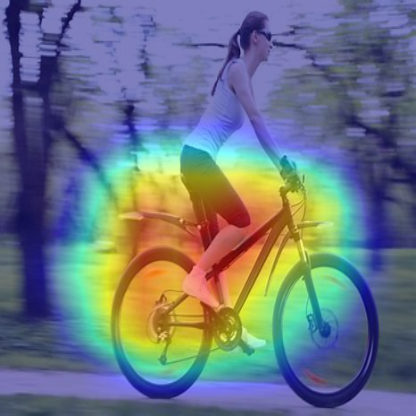

In [ ]:
cam=EigenCAM(model, target_layers, use_cuda=False)
grayscale_cam=cam(tensor)[0, :, :]
cam_image=show_cam_on_image(img, grayscale_cam,use_rgb=True)
Image.fromarray(cam_image)

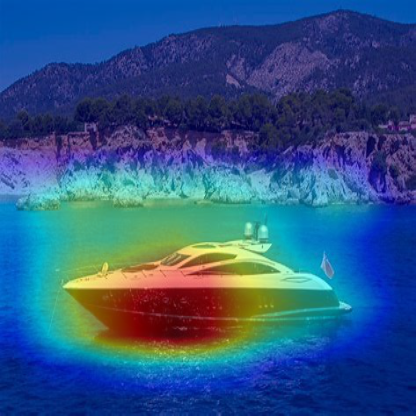

In [ ]:
cam=EigenCAM(model, target_layers, use_cuda=False)
grayscale_cam=cam(tensor)[0, :, :]
cam_image=show_cam_on_image(img, grayscale_cam,use_rgb=True)
Image.fromarray(cam_image)

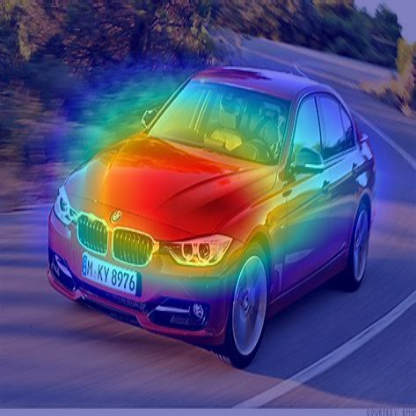

In [ ]:
cam=EigenCAM(model, target_layers, use_cuda=False)
grayscale_cam=cam(tensor)[0, :, :]
cam_image=show_cam_on_image(img, grayscale_cam,use_rgb=True)
Image.fromarray(cam_image)

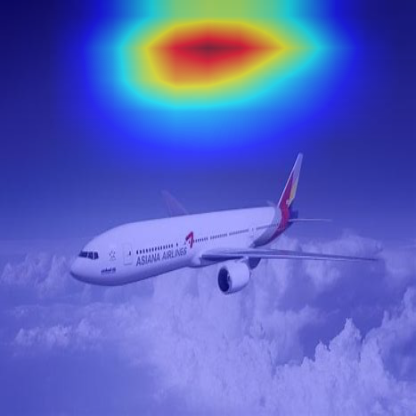

In [ ]:
cam=EigenCAM(model, target_layers, use_cuda=False)
grayscale_cam=cam(tensor)[0, :, :]
cam_image=show_cam_on_image(img, grayscale_cam,use_rgb=True)
Image.fromarray(cam_image)

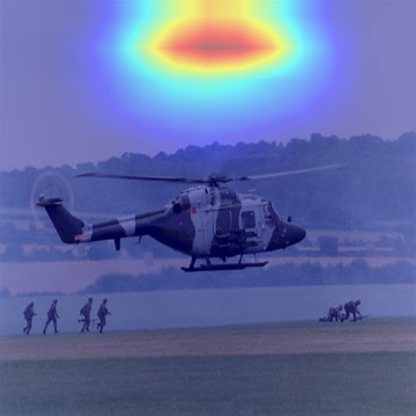

In [ ]:
cam=EigenCAM(model, target_layers, use_cuda=False)
grayscale_cam=cam(tensor)[0, :, :]
cam_image=show_cam_on_image(img, grayscale_cam,use_rgb=True)
Image.fromarray(cam_image)

In [ ]:
def renormalize_cam_in_bounding_boxes(boxes, colors, names, image_float_np, grayscale_cam):
    """Normalize the CAM to be in the range [0, 1] 
    inside every bounding boxes, and zero outside of the bounding boxes. """
    renormalized_cam = np.zeros(grayscale_cam.shape, dtype=np.float32)
    for x1, y1, x2, y2 in boxes:
        renormalized_cam[y1:y2, x1:x2] = scale_cam_image(grayscale_cam[y1:y2, x1:x2].copy())    
    renormalized_cam = scale_cam_image(renormalized_cam)
    eigencam_image_renormalized = show_cam_on_image(image_float_np, renormalized_cam, use_rgb=True)
    image_with_bounding_boxes = draw_detections(boxes, colors, names, eigencam_image_renormalized)
    return image_with_bounding_boxes

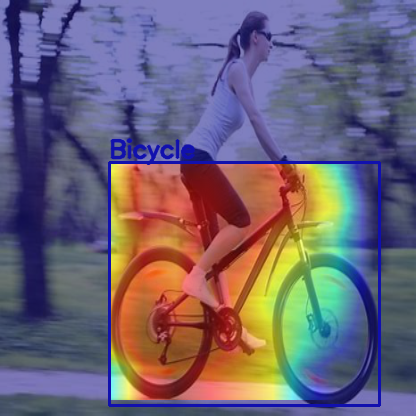

In [ ]:
renormalized_cam_image = renormalize_cam_in_bounding_boxes(boxes, colors, names, img, grayscale_cam)
Image.fromarray(renormalized_cam_image)

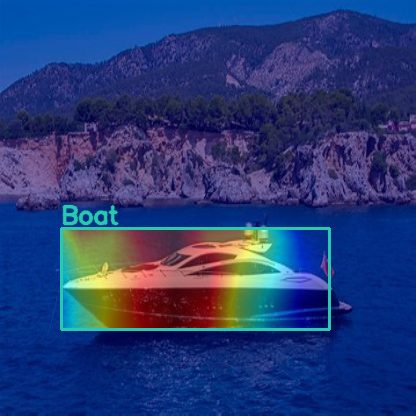

In [ ]:
renormalized_cam_image = renormalize_cam_in_bounding_boxes(boxes, colors, names, img, grayscale_cam)
Image.fromarray(renormalized_cam_image)

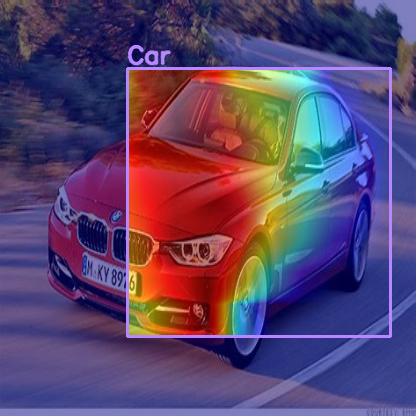

In [ ]:
renormalized_cam_image = renormalize_cam_in_bounding_boxes(boxes, colors, names, img, grayscale_cam)
Image.fromarray(renormalized_cam_image)

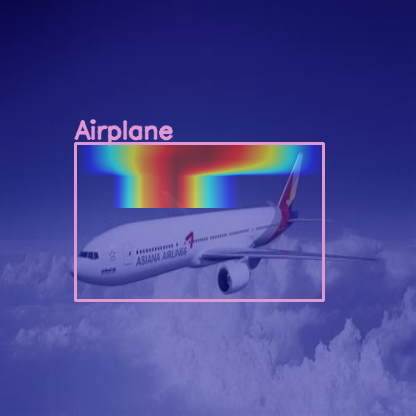

In [ ]:
renormalized_cam_image = renormalize_cam_in_bounding_boxes(boxes, colors, names, img, grayscale_cam)
Image.fromarray(renormalized_cam_image)

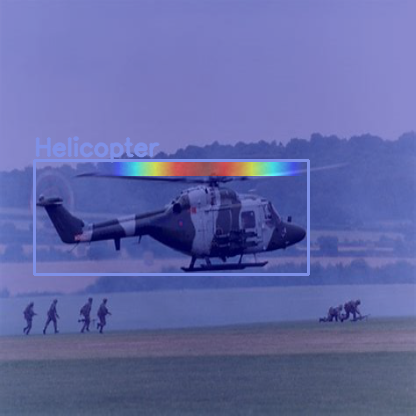

In [ ]:
renormalized_cam_image = renormalize_cam_in_bounding_boxes(boxes, colors, names, img, grayscale_cam)
Image.fromarray(renormalized_cam_image)

### EIGENCAM_CBAM

YOLOv5 🚀 v6.2-239-gf33718f Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
YOLOv5s_mixedfinal summary: 300 layers, 46286784 parameters, 0 gradients, 108.0 GFLOPs
Adding AutoShape... 


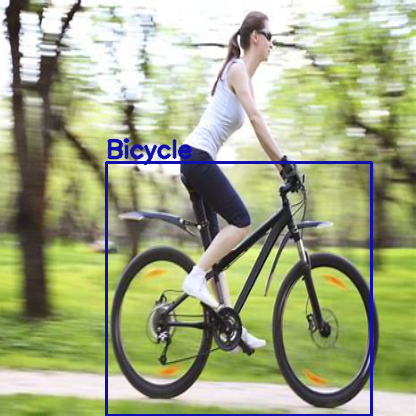

In [ ]:
img=np.array(Image.open('data/mixed-classes-entrega/valid/images/bicycle.jpg'))
img=cv2.resize(img,(416,416))
rgb_img=img.copy()
img=np.float32(img)/255
transform=transforms.ToTensor()
tensor=transform(img).unsqueeze(0)

path_yolo='/content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5'
#path_own_model='yolo5s_gun'
best_weights='/content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5/runs/train/yolo_mixedfinal_cbam_det/weights/best.pt'
model=torch.hub.load(path_yolo,'custom', best_weights,source='local') #,force_reload=True es parametro fuerza a que se busque en el comm.py local
#
model.eval()
model.cpu()
target_layers=[model.model.model.model[-2]]

results=model([rgb_img])
boxes, colors, names = parse_detections(results)
detections=draw_detections(boxes, colors,names,rgb_img.copy())
Image.fromarray(detections)

YOLOv5 🚀 v6.2-239-gf33718f Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
YOLOv5s_mixedfinal summary: 300 layers, 46286784 parameters, 0 gradients, 108.0 GFLOPs
Adding AutoShape... 


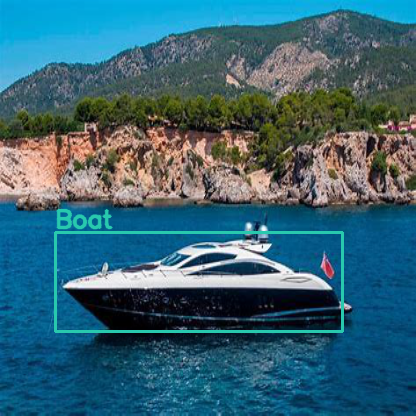

In [ ]:
img=np.array(Image.open('data/mixed-classes-entrega/valid/images/boat.jpg'))
img=cv2.resize(img,(416,416))
rgb_img=img.copy()
img=np.float32(img)/255
transform=transforms.ToTensor()
tensor=transform(img).unsqueeze(0)

path_yolo='/content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5'
#path_own_model='yolo5s_gun'
best_weights='/content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5/runs/train/yolo_mixedfinal_cbam_det/weights/best.pt'
model=torch.hub.load(path_yolo,'custom', best_weights,source='local') #,force_reload=True es parametro fuerza a que se busque en el comm.py local
#
model.eval()
model.cpu()
target_layers=[model.model.model.model[-2]]

results=model([rgb_img])
boxes, colors, names = parse_detections(results)
detections=draw_detections(boxes, colors,names,rgb_img.copy())
Image.fromarray(detections)

YOLOv5 🚀 v6.2-239-gf33718f Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
YOLOv5s_mixedfinal summary: 300 layers, 46286784 parameters, 0 gradients, 108.0 GFLOPs
Adding AutoShape... 


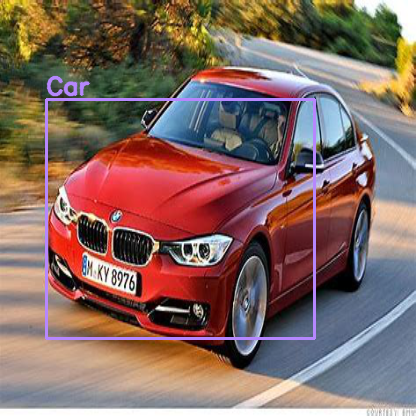

In [ ]:
img=np.array(Image.open('data/mixed-classes-entrega/valid/images/car.jpg'))
img=cv2.resize(img,(416,416))
rgb_img=img.copy()
img=np.float32(img)/255
transform=transforms.ToTensor()
tensor=transform(img).unsqueeze(0)

path_yolo='/content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5'
#path_own_model='yolo5s_gun'
best_weights='/content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5/runs/train/yolo_mixedfinal_cbam_det/weights/best.pt'
model=torch.hub.load(path_yolo,'custom', best_weights,source='local') #,force_reload=True es parametro fuerza a que se busque en el comm.py local
#
model.eval()
model.cpu()
target_layers=[model.model.model.model[-2]]

results=model([rgb_img])
boxes, colors, names = parse_detections(results)
detections=draw_detections(boxes, colors,names,rgb_img.copy())
Image.fromarray(detections)

YOLOv5 🚀 v6.2-239-gf33718f Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
YOLOv5s_mixedfinal summary: 300 layers, 46286784 parameters, 0 gradients, 108.0 GFLOPs
Adding AutoShape... 


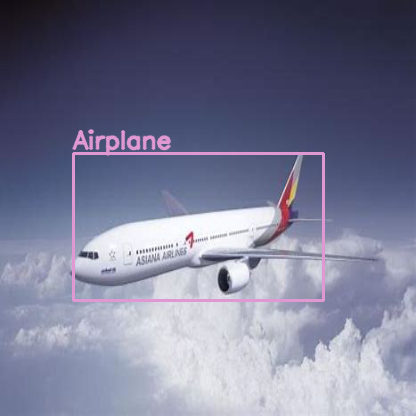

In [ ]:
img=np.array(Image.open('data/mixed-classes-entrega/valid/images/airplane.jpg'))
img=cv2.resize(img,(416,416))
rgb_img=img.copy()
img=np.float32(img)/255
transform=transforms.ToTensor()
tensor=transform(img).unsqueeze(0)

path_yolo='/content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5'
#path_own_model='yolo5s_gun'
best_weights='/content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5/runs/train/yolo_mixedfinal_cbam_det/weights/best.pt'
model=torch.hub.load(path_yolo,'custom', best_weights,source='local') #,force_reload=True es parametro fuerza a que se busque en el comm.py local
#
model.eval()
model.cpu()
target_layers=[model.model.model.model[-2]]

results=model([rgb_img])
boxes, colors, names = parse_detections(results)
detections=draw_detections(boxes, colors,names,rgb_img.copy())
Image.fromarray(detections)

YOLOv5 🚀 v6.2-239-gf33718f Python-3.7.15 torch-1.12.1+cu113 CUDA:0 (Tesla T4, 15110MiB)

Fusing layers... 
YOLOv5s_mixedfinal summary: 300 layers, 46286784 parameters, 0 gradients, 108.0 GFLOPs
Adding AutoShape... 


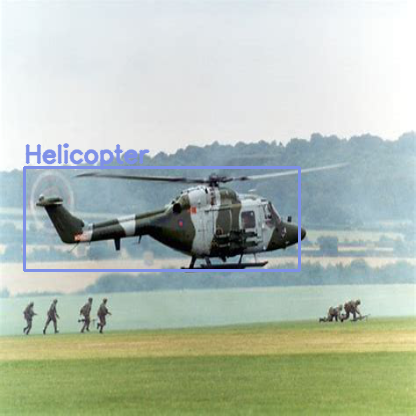

In [ ]:
img=np.array(Image.open('data/mixed-classes-entrega/valid/images/helicopter.jpg'))
img=cv2.resize(img,(416,416))
rgb_img=img.copy()
img=np.float32(img)/255
transform=transforms.ToTensor()
tensor=transform(img).unsqueeze(0)

path_yolo='/content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5'
#path_own_model='yolo5s_gun'
best_weights='/content/drive/MyDrive/AdvDL_2022_3/YOLO/yolov5/runs/train/yolo_mixedfinal_cbam_det/weights/best.pt'
model=torch.hub.load(path_yolo,'custom', best_weights,source='local') #,force_reload=True es parametro fuerza a que se busque en el comm.py local
#
model.eval()
model.cpu()
target_layers=[model.model.model.model[-2]]

results=model([rgb_img])
boxes, colors, names = parse_detections(results)
detections=draw_detections(boxes, colors,names,rgb_img.copy())
Image.fromarray(detections)

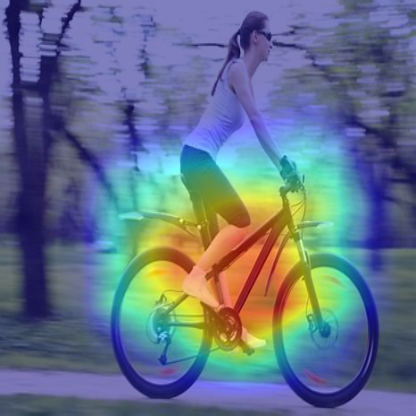

In [ ]:
cam=EigenCAM(model, target_layers, use_cuda=False)
grayscale_cam=cam(tensor)[0, :, :]
cam_image=show_cam_on_image(img, grayscale_cam,use_rgb=True)
Image.fromarray(cam_image)

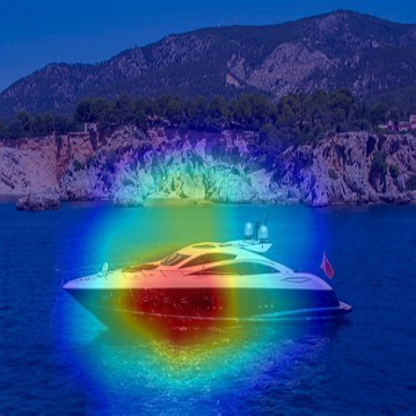

In [ ]:
cam=EigenCAM(model, target_layers, use_cuda=False)
grayscale_cam=cam(tensor)[0, :, :]
cam_image=show_cam_on_image(img, grayscale_cam,use_rgb=True)
Image.fromarray(cam_image)

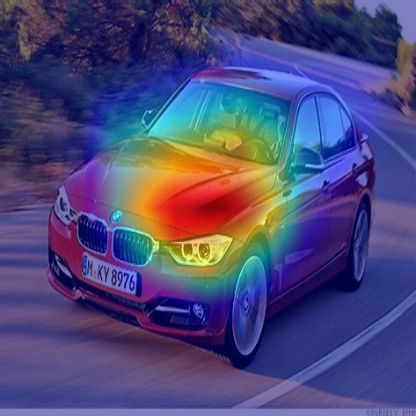

In [ ]:
cam=EigenCAM(model, target_layers, use_cuda=False)
grayscale_cam=cam(tensor)[0, :, :]
cam_image=show_cam_on_image(img, grayscale_cam,use_rgb=True)
Image.fromarray(cam_image)

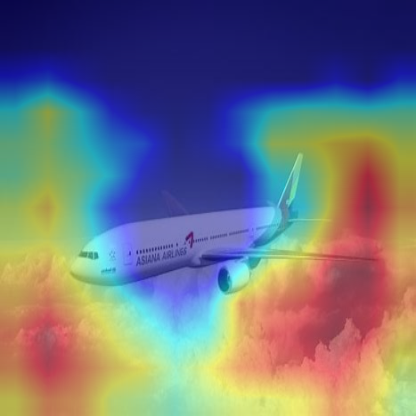

In [ ]:
cam=EigenCAM(model, target_layers, use_cuda=False)
grayscale_cam=cam(tensor)[0, :, :]
cam_image=show_cam_on_image(img, grayscale_cam,use_rgb=True)
Image.fromarray(cam_image)

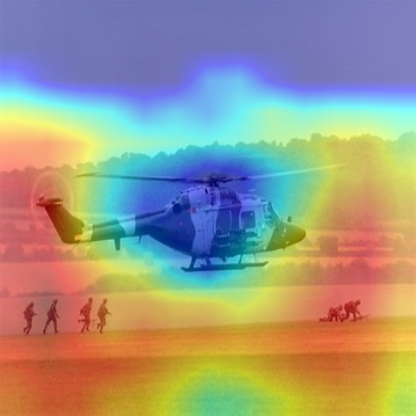

In [ ]:
cam=EigenCAM(model, target_layers, use_cuda=False)
grayscale_cam=cam(tensor)[0, :, :]
cam_image=show_cam_on_image(img, grayscale_cam,use_rgb=True)
Image.fromarray(cam_image)

In [ ]:
def renormalize_cam_in_bounding_boxes(boxes, colors, names, image_float_np, grayscale_cam):
    """Normalize the CAM to be in the range [0, 1] 
    inside every bounding boxes, and zero outside of the bounding boxes. """
    renormalized_cam = np.zeros(grayscale_cam.shape, dtype=np.float32)
    for x1, y1, x2, y2 in boxes:
        renormalized_cam[y1:y2, x1:x2] = scale_cam_image(grayscale_cam[y1:y2, x1:x2].copy())    
    renormalized_cam = scale_cam_image(renormalized_cam)
    eigencam_image_renormalized = show_cam_on_image(image_float_np, renormalized_cam, use_rgb=True)
    image_with_bounding_boxes = draw_detections(boxes, colors, names, eigencam_image_renormalized)
    return image_with_bounding_boxes

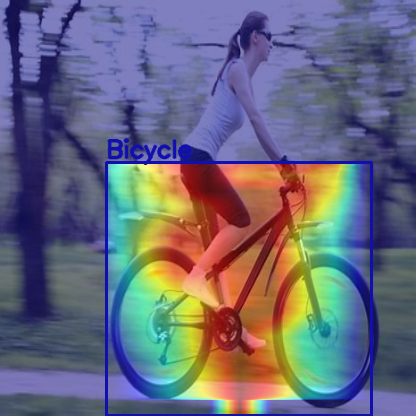

In [ ]:
renormalized_cam_image = renormalize_cam_in_bounding_boxes(boxes, colors, names, img, grayscale_cam)
Image.fromarray(renormalized_cam_image)

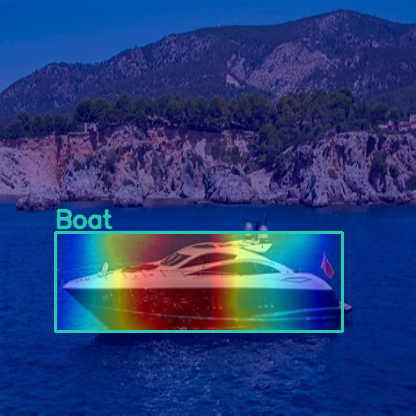

In [ ]:
renormalized_cam_image = renormalize_cam_in_bounding_boxes(boxes, colors, names, img, grayscale_cam)
Image.fromarray(renormalized_cam_image)

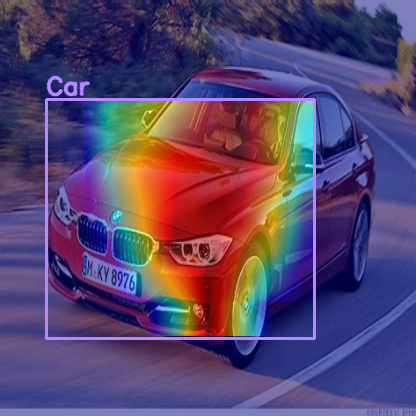

In [ ]:
renormalized_cam_image = renormalize_cam_in_bounding_boxes(boxes, colors, names, img, grayscale_cam)
Image.fromarray(renormalized_cam_image)

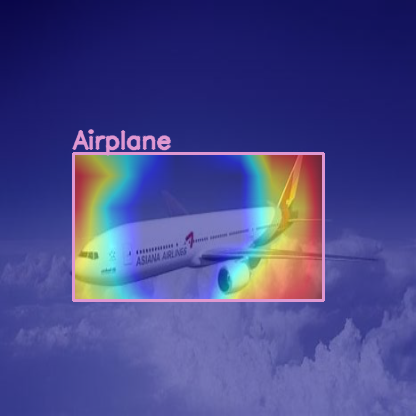

In [ ]:
renormalized_cam_image = renormalize_cam_in_bounding_boxes(boxes, colors, names, img, grayscale_cam)
Image.fromarray(renormalized_cam_image)

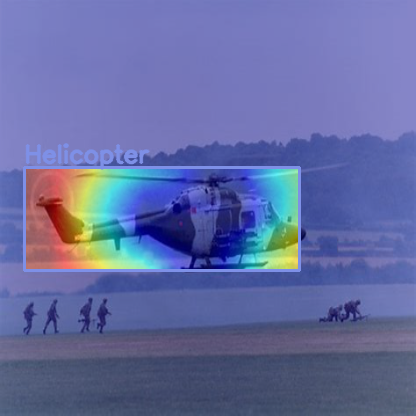

In [ ]:
renormalized_cam_image = renormalize_cam_in_bounding_boxes(boxes, colors, names, img, grayscale_cam)
Image.fromarray(renormalized_cam_image)